In [11]:
import os

datasetName = "KUKUdataset"
labelName = "KUKU"
workingSection = "valid"

imgs = os.listdir(f"data/{datasetName}/{workingSection}/images/")
for i, img in enumerate(imgs):
    txtName = list(img.split(".jpg"))[0]
    os.rename(f"data/{datasetName}/{workingSection}/images/{img}", f"data/{datasetName}/{workingSection}/images/{labelName}{i + 7908}.jpg")
    os.rename(f"data/{datasetName}/{workingSection}/labels/{txtName}.txt", f"data/{datasetName}/{workingSection}/labels/{labelName}{i + 7908}.txt")


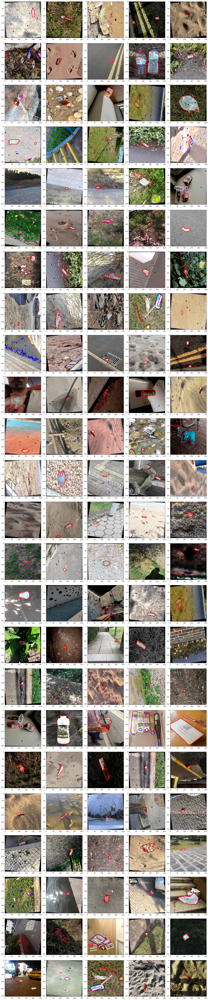

In [3]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

numy, numx = 24, 5
offset = 360
fig, ax = plt.subplots(numy, numx, figsize=(20, 96))

def load_image_and_annotations(i):
    image_id = 2 * i + offset
    image_path = 'data/KUKUdataset/train'
    label = 'KUKU'

    # Load annotations
    annotations = []
    with open(image_path + f"/labels/{label}{image_id}.txt", 'r') as f:
        annotations = [list(line.split(" ")) for line in f.readlines()]

    # Load image
    image = Image.open(image_path + f"/images/{label}{image_id}.jpg")

    return image, annotations

def resize_image(image, max_size=(256, 256)):
    image.thumbnail(max_size)
    return image

for i in range(numx * numy):
    image, annotations = load_image_and_annotations(i)

    original_size = image.size
    image = resize_image(image)
    resized_size = image.size

    ax[i // numx, i % numx].imshow(image)

    for segIndex, seg in enumerate(annotations):
        width, height = original_size
        new_width, new_height = resized_size
        scale_x = new_width / width
        scale_y = new_height / height
        
        polygon = [(float(seg[i]) * width * scale_x, float(seg[i + 1]) * height * scale_y) for i in range(1, len(seg[1:-1]), 2)]
        polygon_patch = patches.Polygon(polygon, closed=True, edgecolor=['r', 'brown', 'k', 'w', 'm', 'pink', 'b'][min(segIndex, 6)], facecolor='none', linewidth=3)
        ax[i // numx, i % numx].add_patch(polygon_patch)

plt.tight_layout()
plt.show()